In [1]:
import numpy as np
from scipy.integrate import odeint
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML

Obtain the Lorenz system data after solving the system ODEs:

In [2]:
def LorenzRHS(y, t, s, r, b):
    x1, x2, x3 = y
    dx1dt = s*(x2 - x1)
    dx2dt = x1*(r - x3) - x2
    dx3dt = x1*x2 - b*x3
    TheRHS = [dx1dt, dx2dt, dx3dt]
    return (TheRHS)

In [3]:
# Parameters:
s, b, r = 10., 8./3, 28.

In [4]:
# time for integration:
t_start = 0
t_stop = 1000
dt = 0.01
t = np.arange(t_start, t_stop, dt)

In [5]:
y0 = np.random.random(size=3) #IC.
print("IC =", y0)

IC = [0.44959187 0.32166936 0.59764257]


In [6]:
%%time
sol = odeint(LorenzRHS, y0, t, args=(s, r, b))

CPU times: user 1.09 s, sys: 16.4 ms, total: 1.11 s
Wall time: 1.13 s


In [7]:
t_stop/dt

100000.0

In [8]:
dis = 95000

In [9]:
dis/(t_stop/dt)

0.95

In [10]:
sol[dis+10,0]

11.409572364130607

Set up the figure, axis, and the plot element we want to animate:

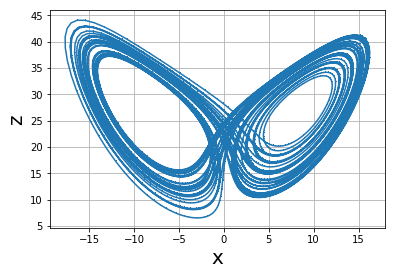

In [11]:
fig, ax = plt.subplots()

ax.grid(True)

# Lorenz system phase space x vs z:
ax.plot(sol[dis:,0], sol[dis:,2], ",-")

ax.set_xlabel('x', fontsize=20)
ax.set_ylabel('z', fontsize=20)

# The dot:
TheDot, = ax.plot([], [], "ro-", lw=2)
# Note the comma!

Define the initialization function, which plots the background of each frame:

In [12]:
def init():
    TheDot.set_data([], [])
    return (TheDot,)
# Note the comma!

Define the animation function, which is called for each new frame:

In [13]:
def animate(i):
    
    x = sol[dis+i, 0]
    y = sol[dis+i, 2]
    
    TheDot.set_data(x, y)
    
    return (TheDot,)
# Note the comma!

Compile the animation. Setting blit=True will only redraw parts that have changed:

In [14]:
NumOfAnim = len(sol[dis:,0])

In [15]:
len(range(0, int(NumOfAnim/2), 10))

250

In [16]:
anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=range(0, int(NumOfAnim/2), 10),
                               interval=50,
                               blit=True, repeat=False)

In [17]:
%%time
HTML(anim.to_jshtml())

CPU times: user 20.8 s, sys: 443 ms, total: 21.3 s
Wall time: 21.7 s
